In [1]:
import os
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from pandas.io.parsers import read_csv
from sklearn.utils import shuffle

In [2]:
import cv2

In [3]:
#import swifter
import concurrent.futures

In [4]:
FTRAIN = "/images/params.csv"

In [5]:
import tensorflow as tf
from keras.backend.tensorflow_backend import set_session
print(tf.__version__)
#config = tf.ConfigProto()
#config.gpu_options.per_process_gpu_memory_fraction = 0.95
#config.gpu_options.visible_device_list = "0"
#### 1 GPU1
#### 2 GPU2
#### 0 GPU3
#### 4 GPU4
#set_session(tf.Session(config=config))

1.15.0


Using TensorFlow backend.


In [6]:
input_height, input_width = 400, 400

In [7]:
def get_rotate_matrix(scale_limit=(-0.1, 0.1),
                           rotate_limit=(-5, 5), aspect_limit=(0, 0)):
    angle = np.random.uniform(rotate_limit[0], rotate_limit[1])  # degree
    scale = np.random.uniform(1 + scale_limit[0], 1 + scale_limit[1])
    aspect = np.random.uniform(1 + aspect_limit[0], 1 + aspect_limit[1])
    sx = scale * aspect / (aspect ** 0.5)
    sy = scale / (aspect ** 0.5)
    
    cc = np.math.cos(angle / 180 * np.math.pi) * sx
    ss = np.math.sin(angle / 180 * np.math.pi) * sy
    return np.array([[cc, -ss], [ss, cc]])


In [8]:
def get_image(fname):
    img = cv2.imread(fname, cv2.IMREAD_ANYDEPTH | cv2.IMREAD_GRAYSCALE)
    #if img is None:
    #     return None
    img = img.astype(np.float32)
    img = cv2.resize(img, (input_width, input_height))
    
    ms = cv2.moments(img)
    rotate = -1 if ms['m10'] > ms['m00'] * (input_width - 1.) / 2 else 1
    ##mirrorY = ms['m01'] > ms['m00'] * (input_height - 1.) / 2
    
    if rotate == -1:
        img = cv2.flip(img, -1)
    
    img = img[np.newaxis, :]
    return img, rotate

In [9]:
def NormalizeData(data):
    return (data - np.min(data)) / float(np.max(data) - np.min(data))

In [10]:
def plot_sample(X,y,axs):
    '''
    kaggle picture is 96 by 96
    y is rescaled to range between -1 and 1
    '''
    
    axs.imshow(X.reshape(input_width,input_height),cmap="gray")
    axs.scatter((input_width//2)*y[0::2]+ (input_width//2),(input_height//2)*y[1::2]+ (input_height//2))
    
def load(ids):
    """
    load test/train data
    cols : a list containing landmark label names.
           If this is specified, only the subset of the landmark labels are 
           extracted. for example, cols could be:
           
          [left_eye_center_x, left_eye_center_y]
            
    return: 
    X: 2-d numpy array (Nsample, Ncol*Nrow)
    y: 2-d numpy array (Nsample, Nlandmarks*2) 
       In total there are 15 landmarks. 
       As x and y coordinates are recorded, u.shape = (Nsample,30)
       
    """

    #fname = FTRAIN
    #df = read_csv(os.path.expanduser(fname)) 
    
    df = ids.copy()
    
    df.reset_index(drop=True, inplace=True)
    
    #df['Image'] = df['Image'].apply(lambda im: np.fromstring(im, sep=' '))
    
    #df[['Image','rotate']] = df['id_string'].apply(lambda im: pd.Series(get_image('/images/all_images/' + im + '.tif')))

    #df[['Image','rotate']] = df['id_string'].swifter.allow_dask_on_strings(enable=True).apply(lambda im: pd.Series(get_image('/images/all_images/' + im + '.tif')))
    
    #with concurrent.futures.ThreadPoolExecutor(max_workers=32) as pool:
    #    df[['Image','rotate']] = pd.DataFrame(pool.map(lambda im: pd.Series(get_image('/images/all_images/' + im + '.tif')), df['id_string'], chunksize=10)) # Without a progressbar

    def ImageFun(im, shift_limit=(-0.0625, 0.0625), borderMode=cv2.BORDER_REFLECT_101):
        #image, rotate = get_image('/images/all_images/' + im + '.tif')
        fname = '/images/all_images/' + im + '.tif'
        img = cv2.imread(fname, cv2.IMREAD_ANYDEPTH | cv2.IMREAD_GRAYSCALE)
        img = img.astype(np.float32)
        #img = cv2.resize(img, (input_width, input_height))

        height, width = img.shape[:2]
        
        ms = cv2.moments(img)
        rotate = -1 if ms['m10'] > ms['m00'] * (width - 1.) / 2 else 1
        ##mirrorY = ms['m01'] > ms['m00'] * (input_height - 1.) / 2
        
        rotate_matrix = get_rotate_matrix()
        
        dx = round(np.random.uniform(shift_limit[0], shift_limit[1]))
        dy = round(np.random.uniform(shift_limit[0], shift_limit[1]))
        box1 = np.array([[0, 0], [input_width, 0], [input_width, input_height], [0, input_height], ])
        box1 = box1 - np.array([input_width / 2, input_height / 2])
        box1 = np.dot(box1, rotate_matrix.T) + np.array([input_width * (0.5 + dx), input_height * (0.5 + dy)])

        box0 = np.array([[0, 0], [width, 0], [width, height], [0, height], ])
        
        box0 = box0.astype(np.float32)
        box1 = box1.astype(np.float32)
        mat = cv2.getPerspectiveTransform(box0, box1)
        img = cv2.warpPerspective(img, mat, (input_width, input_height), flags=cv2.INTER_CUBIC, borderMode=borderMode, borderValue=(0))

        if rotate == -1:
            img = cv2.flip(img, -1)
        
        img = img[np.newaxis, :]
    
        return img, rotate, rotate_matrix, dx, dy
    
    with concurrent.futures.ThreadPoolExecutor(max_workers=32) as pool:
        df[['Image','rotate', 'rotate_matrix', 'dx', 'dy']] = pd.DataFrame(list(pool.map(ImageFun, df['id_string'], chunksize=10))) # Without a progressbar

    
        
    '''
    with concurrent.futures.ThreadPoolExecutor(max_workers=8) as pool:
        #fut = pool.map(ImageFun, df['id_string'], chunksize=10) # Without a progressbar
        fut = {pool.submit(ImageFun, data):data for data in df['id_string']}
        #res = list([(list(x.result() for x in concurrent.futures.as_completed(fut)))])
        res = pd.DataFrame(x.result() for x in concurrent.futures.as_completed(fut))
        #print('res')
        #print(res)
        df[['Image','rotate', 'rotate_matrix', 'dx', 'dy']] = res
    '''     
        
    #df[['Image','rotate', 'rotate_matrix', 'dx', 'dy']] = df['id_string'].apply(lambda im: pd.Series(ImageFun(im)))
    
    del df['id_string']

    #if cols:  
    #    df = df[list(cols) + ['Image']]

    #myprint = df.count()
    #myprint = myprint.reset_index()
    #print(myprint)  
    
    ## row with at least one NA columns are removed!
    df = df.dropna()  

    '''

    #X = np.vstack(df['Image'].values) / 255.  # changes valeus between 0 and 1
    #X = np.vstack(df['Image'].values) / 65535.  # changes valeus between 0 and 1
    X = NormalizeData(np.vstack(df['Image'].values))
    X = X.astype(np.float32)

    print(df['rotate'])
    
    ## standardization of the response
    y = df[df.columns[:-2]]#.values
    #y = (y - 48) / 48  # y values are between [-1,1]
    y = (y - 0.5) * 2
    y = y.mul(df['rotate'], axis='rows')
    y = y.values
    X, y = shuffle(X, y, random_state=42)  # shuffle data
    y = y.astype(np.float32)
    
    #del df['rotate']
    
    return X, y
    
    '''

    all_x = []
    all_y = []
    for index, row in df.iterrows():
        X = NormalizeData(row['Image'])
        X = X.astype(np.float32)
        all_x.append([X])
        
        y = row[:-67]
        
        box1 = np.array([[0, 0], [1, 0], [1, 1], [0, 1], ])
        box1 = box1 - np.array([0.5, 0.5])
        box1 = np.dot(box1, row['rotate_matrix'].T) + np.array([0.5 + row['dx'], 0.5 + row['dy']])

        box0 = np.array([[0, 0], [1, 0], [1, 1], [0, 1], ])
        
        box0 = box0.astype(np.float32)
        box1 = box1.astype(np.float32)
        mat = cv2.getPerspectiveTransform(box0, box1)

        y = y.astype(np.float32)

        y = cv2.perspectiveTransform(np.array(y).reshape(-1, 1, 2), mat)
        
        y = y.reshape(-1, 62)
        #y = y[np.newaxis, :]
        
        #y = np.array(list(y[0][0])) 
        
        y = (y - 0.5) * 2
        #y = y.mul(row['rotate'], axis='rows')
        y = y * row['rotate']
        #y = y.values
        
        #y = y.reshape(-1, 1)
        
        y = y.astype(np.float32)
        all_y.append(y)

    
    all_x = np.concatenate(all_x)
    all_y = np.concatenate(all_y)
    
    all_x, all_y = shuffle(all_x, all_y, random_state=42)  # shuffle data
    
    return all_x, all_y
        

def load2d(ids):

    re = load(ids)
    
    X = re[0].reshape(-1,input_width,input_height,1)
    y = re[1]

    return X, y

def plot_loss(hist,name,plt,RMSE_TF=False):
    '''
    RMSE_TF: if True, then RMSE is plotted with original scale 
    '''
    loss = hist['loss']
    val_loss = hist['val_loss']
    if RMSE_TF:
        loss = np.sqrt(np.array(loss))*(input_height//2) 
        val_loss = np.sqrt(np.array(val_loss))*(input_height//2) 
        
    plt.plot(loss,"--",linewidth=3,label="train:"+name)
    plt.plot(val_loss,linewidth=3,label="val:"+name)

In [11]:
## load data
#X, y = load2d()
#X.shape
#y.shape

from sklearn import model_selection

img_ids = read_csv(os.path.expanduser(FTRAIN)) 
train_ids, validation_ids = model_selection.train_test_split(img_ids, random_state=42, test_size=0.20)
 

In [12]:
def generator(ids, batch_size):

  X_data, y_data = load2d(ids)    
  samples_per_epoch = X_data.shape[0]
  number_of_batches = samples_per_epoch/batch_size
  counter=0

  while 1:

    X_batch = np.array(X_data[batch_size*counter:batch_size*(counter+1)]).astype('float32')
    y_batch = np.array(y_data[batch_size*counter:batch_size*(counter+1)]).astype('float32')
    counter += 1
    yield X_batch,y_batch

    #restart counter to yeild data in the next epoch as well
    if counter >= number_of_batches:
        counter = 0
        X_data, y_data = load2d(ids)    
        samples_per_epoch = X_data.shape[0]
        number_of_batches = samples_per_epoch/batch_size
        

In [13]:
def plot_data(img, landmarks, axis):
    """
    Plot image (img), along with normalized facial keypoints (landmarks)
    """
    
    li = []
    for x in range(31):
        li.append(0 if(x > 30) else 100)
    
    axis.imshow(np.squeeze(img), cmap='gray') # plot the image
    landmarks = landmarks * 200 + 200 # undo the normalization
    # Plot the keypoints
    axis.scatter(landmarks[0::2],
        landmarks[1::2],
        marker='o',
        #c='c',
        c=li,
        cmap="plasma",
        s=10)

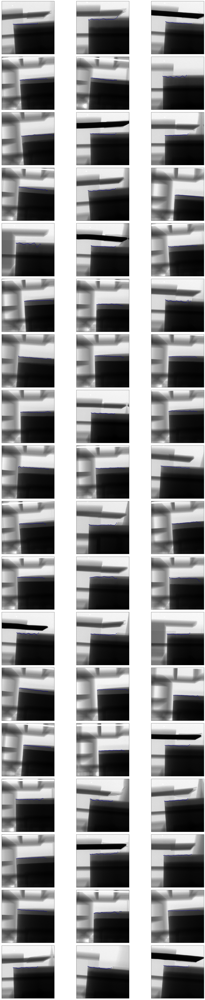

In [14]:
X, y = load2d(validation_ids)
fig = plt.figure(figsize=(20,100))
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05)
for i in range(54):
    ax = fig.add_subplot(20, 3, i + 1, xticks=[], yticks=[])
    plot_data(X[i], y[i], ax)

In [15]:
import keras

from keras.models import Sequential
from keras.layers import Dense, Activation
from keras.optimizers import SGD

from keras import regularizers

from keras.layers import Conv2D, MaxPooling2D,Flatten, Dropout

#l2 = regularizers.l2(0.01)

def SimpleCNN():
    model = Sequential()
    model.add(Conv2D(filters=16, kernel_size=3, activation='relu', input_shape=(input_width,input_height, 1)))
    model.add(MaxPooling2D(pool_size=2))

    model.add(Conv2D(filters=32, kernel_size=3, activation='relu'))
    model.add(MaxPooling2D(pool_size=2))

    model.add(Conv2D(filters=64, kernel_size=3, activation='relu'))
    model.add(MaxPooling2D(pool_size=2))

    model.add(Conv2D(filters=128, kernel_size=3, activation='relu'))
    model.add(MaxPooling2D(pool_size=2))

    model.add(Flatten())

    model.add(Dense(512, activation='relu'))
    model.add(Dropout(0.2))
    
    model.add(Dense(62))
    
    model.compile(optimizer='adam', loss='mse', metrics=['accuracy'])

    return(model)

In [16]:
%%time
model2 = SimpleCNN()

model2.summary()

Instructions for updating:
If using Keras pass *_constraint arguments to layers.

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 398, 398, 16)      160       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 199, 199, 16)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 197, 197, 32)      4640      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 98, 98, 32)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 96, 96, 64)        18496     
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 48, 48, 64)        0         
______________________________________

In [17]:
BATCH_SIZE=32 

train_generator = generator(train_ids, BATCH_SIZE)
valid_generator = generator(validation_ids, BATCH_SIZE)
VALIDATION_STEPS = int(len(validation_ids) / BATCH_SIZE)



In [18]:

#validation_split=0.2,, batch_size=32
hist2 = model2.fit_generator(train_generator, validation_data=valid_generator, validation_steps=VALIDATION_STEPS, steps_per_epoch = 101, epochs = 200,verbose=True)


Epoch 1/200
101/101 [==============================] - 90s 892ms/step - loss: 0.0125 - accuracy: 0.5558 - val_loss: 0.0016 - val_accuracy: 0.9883
Epoch 2/200
101/101 [==============================] - 51s 504ms/step - loss: 0.0028 - accuracy: 0.7053 - val_loss: 8.7788e-04 - val_accuracy: 1.0000
Epoch 3/200
101/101 [==============================] - 62s 612ms/step - loss: 0.0021 - accuracy: 0.7630 - val_loss: 5.2086e-04 - val_accuracy: 1.0000
Epoch 4/200
101/101 [==============================] - 64s 632ms/step - loss: 0.0018 - accuracy: 0.8044 - val_loss: 3.8099e-04 - val_accuracy: 1.0000
Epoch 5/200
101/101 [==============================] - 67s 663ms/step - loss: 0.0014 - accuracy: 0.8414 - val_loss: 3.1270e-04 - val_accuracy: 1.0000
Epoch 6/200
101/101 [==============================] - 49s 488ms/step - loss: 0.0014 - accuracy: 0.8754 - val_loss: 6.0595e-04 - val_accuracy: 1.0000
Epoch 7/200
101/101 [==============================] - 70s 696ms/step - loss: 0.0012 - accuracy: 0.9012

Epoch 53/200
101/101 [==============================] - 64s 638ms/step - loss: 2.9284e-04 - accuracy: 0.9994 - val_loss: 1.8299e-04 - val_accuracy: 1.0000
Epoch 54/200
101/101 [==============================] - 64s 636ms/step - loss: 3.4650e-04 - accuracy: 1.0000 - val_loss: 1.4376e-04 - val_accuracy: 1.0000
Epoch 55/200
101/101 [==============================] - 63s 625ms/step - loss: 3.4572e-04 - accuracy: 1.0000 - val_loss: 2.1035e-04 - val_accuracy: 1.0000
Epoch 56/200
101/101 [==============================] - 61s 605ms/step - loss: 3.4504e-04 - accuracy: 0.9997 - val_loss: 2.6467e-04 - val_accuracy: 1.0000
Epoch 57/200
101/101 [==============================] - 49s 485ms/step - loss: 3.1249e-04 - accuracy: 1.0000 - val_loss: 1.3257e-04 - val_accuracy: 1.0000
Epoch 58/200
101/101 [==============================] - 64s 633ms/step - loss: 2.9668e-04 - accuracy: 1.0000 - val_loss: 1.9310e-04 - val_accuracy: 1.0000
Epoch 59/200
101/101 [==============================] - 64s 634ms/step

Epoch 106/200
101/101 [==============================] - 64s 637ms/step - loss: 2.5136e-04 - accuracy: 1.0000 - val_loss: 1.5144e-04 - val_accuracy: 1.0000
Epoch 107/200
101/101 [==============================] - 63s 625ms/step - loss: 2.7396e-04 - accuracy: 1.0000 - val_loss: 1.5499e-04 - val_accuracy: 1.0000
Epoch 108/200
101/101 [==============================] - 51s 504ms/step - loss: 2.6640e-04 - accuracy: 1.0000 - val_loss: 1.1709e-04 - val_accuracy: 1.0000
Epoch 109/200
101/101 [==============================] - 70s 693ms/step - loss: 2.3757e-04 - accuracy: 1.0000 - val_loss: 1.4950e-04 - val_accuracy: 1.0000
Epoch 110/200
101/101 [==============================] - 83s 823ms/step - loss: 2.4651e-04 - accuracy: 1.0000 - val_loss: 1.2978e-04 - val_accuracy: 1.0000
Epoch 111/200
101/101 [==============================] - 71s 703ms/step - loss: 2.4796e-04 - accuracy: 1.0000 - val_loss: 2.0869e-04 - val_accuracy: 1.0000
Epoch 112/200
101/101 [==============================] - 66s 652

101/101 [==============================] - 66s 649ms/step - loss: 2.3209e-04 - accuracy: 1.0000 - val_loss: 1.1639e-04 - val_accuracy: 1.0000
Epoch 159/200
101/101 [==============================] - 65s 648ms/step - loss: 2.4700e-04 - accuracy: 1.0000 - val_loss: 1.2651e-04 - val_accuracy: 1.0000
Epoch 160/200
101/101 [==============================] - 51s 502ms/step - loss: 2.3406e-04 - accuracy: 1.0000 - val_loss: 1.3113e-04 - val_accuracy: 1.0000
Epoch 161/200
101/101 [==============================] - 66s 654ms/step - loss: 2.2651e-04 - accuracy: 1.0000 - val_loss: 1.1710e-04 - val_accuracy: 1.0000
Epoch 162/200
101/101 [==============================] - 67s 663ms/step - loss: 2.4335e-04 - accuracy: 1.0000 - val_loss: 1.0386e-04 - val_accuracy: 1.0000
Epoch 163/200
101/101 [==============================] - 65s 644ms/step - loss: 2.2044e-04 - accuracy: 1.0000 - val_loss: 1.0263e-04 - val_accuracy: 1.0000
Epoch 164/200
101/101 [==============================] - 65s 645ms/step - loss

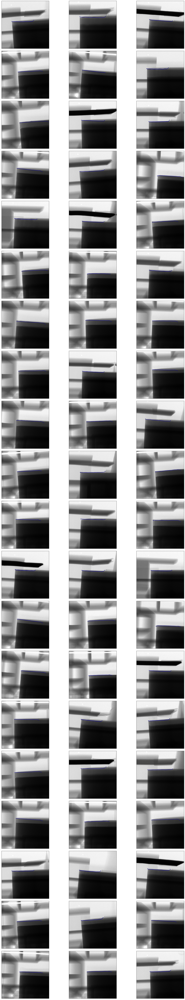

In [19]:
y_test = model2.predict(X)
fig = plt.figure(figsize=(20,100))
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05)
for i in range(60):
    ax = fig.add_subplot(20, 3, i + 1, xticks=[], yticks=[])
    plot_data(X[i], y_test[i], ax)

In [20]:
    df = read_csv(os.path.expanduser("/images/bads.lst"), header=None) 


In [21]:
df


,0
0,20201218103659489_SNG1218103619_6
1,20201218103848471_SNG1218103632_6
2,20201218105035861_SNG1218103921_6
3,20201218105037050_SNG1218103907_9
4,20201218105210845_SNG1218104028_6
5,20201218113453354_SNG1218113419_6
6,20201218182322747_SNG1218174118_6
7,20201218182326828_SNG1218174118_9
8,20201218182430908_SNG1218174118_6
9,20201218182458236_SNG1218174118_6


In [22]:
df[0] = df[0].apply(lambda im: get_image('/images/all_images/' + im + '.tif')[0])

In [23]:
X_test = NormalizeData(np.vstack(df[0].values))
X_test = X_test.astype(np.float32)
X_test = X_test.reshape(-1,input_width,input_height,1)

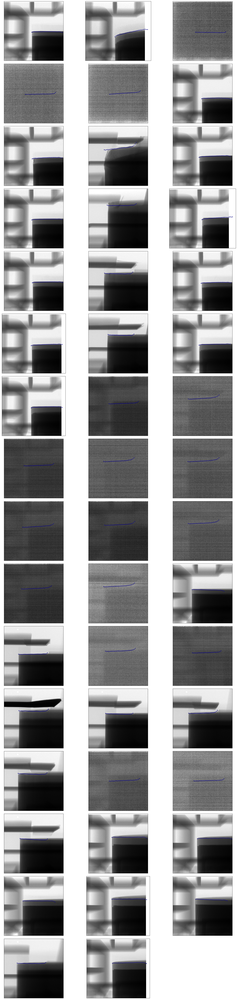

In [24]:
y_test = model2.predict(X_test)
fig = plt.figure(figsize=(20,100))
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05)
for i in range(len(df)):
    ax = fig.add_subplot(20, 3, i + 1, xticks=[], yticks=[])
    plot_data(X_test[i], y_test[i], ax)